# Exam

In [11]:
import pandas as pd
import numpy as np

import pymc3 as pm
from scipy import stats

import plotly.graph_objs as go
from plotly import tools
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

Main code avaiable in `mcmc_biprobit.py`.

The code has been translated to Python with only minor sysntactic changes (e.g. indicing in Python start from zero).

To load the code in the notbook run:

`%load mcmc_biprobit.py`

If you want only to run the code in the notebook environment (as will be done in Part C), then use:

`%run -i mcmc_biprobit.py`

---
---

## Part A: The bivariate probit model

---
### Question A.1

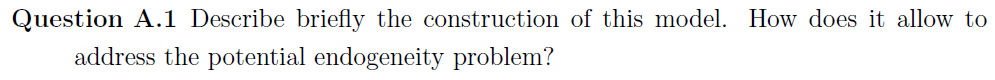

The model is a bivariate probit model with with the linear predictors of the latent variables given by a set of 2 equations:
$$
\begin{cases}
    y^*_{1i} & = x'_i\beta_1+\delta y_{2i}+\epsilon_{1i}\\
    y^*_{2i} & = x'_i\beta_2+\gamma z_i+\epsilon_{2i}\\
\end{cases}
$$
with error terms following a bivariate normal distribution:

$$
\begin{pmatrix}
    \epsilon_{1i}\\
    \epsilon_{2i}
\end{pmatrix} \overset{i.i.d}{\sim}  N
\begin{pmatrix}
\begin{pmatrix}
0\\
0
\end{pmatrix}\!,&
\begin{pmatrix}
1 & \rho\\
\rho & 1
\end{pmatrix}
\end{pmatrix}
$$
and the link to the observed variables:
$$ 
y_{ji} = \begin{cases}
            1 & \text{iff}\;\: y^*_{i} > 0 \\
            0 & \text{iff}\;\: y^*_{i} \leq 0
        \end{cases}
$$
The latent variable $y^*_{2i}$ is assumed to have a linear relationship to the explanatory variables $x_i$ and $z_i$.
On the other side, in addition to the $x_i$ variables, $y_{1i}$ depends also on the observed variable $y_{2i}$, which might be a source of endogeneity if it were to dependent on unobserved factors.

If one were to estimate the model separately (for each $y_j$), for varying $y_{2i}$ and non-zero $\rho$ we would have:
$$
E\left(y_{2i}\epsilon_{1i}\right) \not= 0
$$
What this means is that data is not actually random. And Bayesians typically assume that data comes form an exchangeable distribution as independently and identically distributed.

Formally, if we factor the joint distribution as:
$$p(y^*_1, y_1, y_2,\beta_1, \delta, \rho) = p(y_1\mid y^*, y_2, \beta_1, \delta, \rho)p(y^*, y_2 \mid\beta_1, \delta, \rho)p(\beta_1, \delta, \rho)$$
The assumed draws from $p(y^*, y_2 \mid\beta_1, \delta, \rho)$ would not be independent.

Unless we are willing to model the relationship between $y_{2i}$ (possibly through $y^*_{2i}$ which determines it) and $\epsilon_{1i}$, this will bias and affect the identification of our estimates (i.e. simulation draws from the posterior density of the parameters).

Modeling the linear predictors in a simultaneous equations fashion helps address the potential enogeneity problem.

This approach is similar to the instrumental variable approach except that now, rather than specifying the conditional distribution of $\epsilon_{1i}\mid \epsilon_{2i}$ (which is essentially what sequential estimation would do) one simply specifies their joint distribution. Within a Bayesian framework this helps addressing the problem.

---
### Question A.2

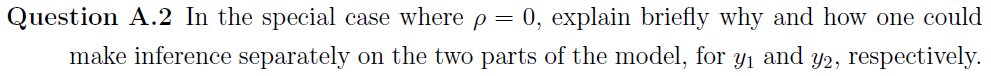

In the special case where $\rho = 0$, one could make inference separately on the 2 parts of the model because there would be no endogeneity effects present.

Provided the model specification one could implement a simple probit model:

1. Derive the likelihood function
    $$L\left(\beta_1, \delta\right) \propto  \prod_{i=1}^n p_i^{y_{1i}}(1-p_i)^{1-y_{1i}} $$
    
    where $p_i = p(y_{1i}=1) = \Phi\left(x'\beta_1+\delta y_{2i}\right)$
    

2. Specify a prior for the parameters. 

Typically normal priors are assumed, but that is by no means essential to inference.
3. Derive the posterior.

If uniform priors are assumed, then the posterior would be:
$$p\left(\beta_1, \delta, y^* \mid y_1, y2\right) \propto  \prod_{i=1}^n \Phi\left(x_i'\beta_1+\delta y_{2i}\right)^{y_{1i}}\left(1-\Phi\left(x'\beta_1+\delta y_{2i}\right)\right)^{1-y_{1i}} $$
4. Simulate from the posterior to estimate the distribution of the parameters

With the posterior density established, MCMC sampling can be conducted by using the unnormalized posterior (Metropolis-Hastings) or one could derive the conditional distribution for $\beta_1$ and $\delta$ and run a simple Gibbs sampling algorithm.

For the second part the procedure is virtually the same.

---
### Question A.3

The likelihood function is the product of sampling densities for each observation in the sample.

One instance $\left(y_{1i},y_{2i}\right)$ in the sample may be one out of 4 possible observations in the sample:
$\left(y_{1i} = 1, y_{2i} = 1\right)$,
$\left(y_{1i} = 0, y_{2i} = 1\right)$,
$\left(y_{1i} = 1, y_{2i} = 0\right)$,
$\left(y_{1i} = 0, y_{2i} = 0\right)$.

We have:

$$p(\left(y_{1i} = 1, y_{2i} = 1\right)\mid \theta) = p\left(\epsilon_{1i} \leq x'_i\beta_1+\delta y_{2i}, \epsilon_{2i} \leq x'_i\beta_2+\gamma z_i \mid \theta\right) = \int_{-\infty}^{x'_i\beta_1+\delta y_{2i}} \int_{-\infty}^{x'_i\beta_2+\gamma z_i} \phi_2(\epsilon_{1i}, \epsilon_{2i}|\rho)d\epsilon_{1i}d\epsilon_{2i}$$
$$p(\left(y_{1i} = 0, y_{2i} = 1\right)\mid \theta) = p\left(\epsilon_{1i} > x'_i\beta_1+\delta y_{2i}, \epsilon_{2i} \leq x'_i\beta_2+\gamma z_i \mid \theta\right) = \int_{x'_i\beta_1+\delta y_{2i}}^{\infty} \int_{-\infty}^{x'_i\beta_2+\gamma z_i} \phi_2(\epsilon_{1i}, \epsilon_{2i}|\rho)d\epsilon_{1i}d\epsilon_{2i}$$
$$p(\left(y_{1i} = 1, y_{2i} = 0\right)\mid \theta) = p\left(\epsilon_{1i} \leq x'_i\beta_1+\delta y_{2i}, \epsilon_{2i} > x'_i\beta_2+\gamma z_i \mid \theta\right) = \int_{-\infty}^{x'_i\beta_1+\delta y_{2i}} \int_{x'_i\beta_2+\gamma z_i}^{\infty} \phi_2(\epsilon_{1i}, \epsilon_{2i}|\rho)d\epsilon_{1i}d\epsilon_{2i}$$
$$p(\left(y_{1i} = 0, y_{2i} = 0\right)\mid \theta) = p\left(\epsilon_{1i} > x'_i\beta_1+\delta y_{2i}, \epsilon_{2i} > x'_i\beta_2+\gamma z_i \mid \theta\right) = \int_{x'_i\beta_1+\delta y_{2i}}^{\infty} \int_{x'_i\beta_2+\gamma z_i}^{\infty} \phi_2(\epsilon_{1i}, \epsilon_{2i}|\rho)d\epsilon_{1i}d\epsilon_{2i}$$

with $\phi_2(\epsilon_{1i}, \epsilon_{2i}|\rho)$ as defined. This function is being used provided that we are in a bivariate probit model and the link function used in a bivariate probit model is the cumulative distribution function of a bivariate normal distribution. To compute various regions of the CDF we perform the double intergration over some specified domains.

What changes in the last expression from case to case is the domain of integration.
If we define:

$$
A_{1i} = \begin{cases}
            ( -\infty, \;\;x'_i\beta_1+\delta y_{2i} ] &if\;\; y_{1i} = 1  \\
            ( x'_i\beta_1+\delta y_{2i},\;\; \infty  ) &if\;\; y_{1i} = 0 \\
         \end{cases}
$$
and
$$
A_{2i} = \begin{cases}
            ( -\infty, \;\;x'_i\beta_2+\gamma z_i ] &if\;\; y_{2i} = 1  \\
            ( x'_i\beta_2+\gamma z_i,\;\; \infty  ) &if\;\; y_{2i} = 0 \\
         \end{cases}
$$

Then each of the cases above may be written as:

$$\int_{A_{1i}}\int_{A_{2i}} \phi_2\left(\epsilon_{1i}\epsilon_{2i}\mid \rho\right)d\epsilon_{2i}d\epsilon_{1i}$$.

Now, if we take the product over all the sampling densities we obtain the desired likelihood function:
$$L(\theta\mid data) = \prod^N_{i=1}\int_{A_{1i}}\int_{A_{2i}} \phi_2\left(\epsilon_{1i}\epsilon_{2i}\mid \rho\right)d\epsilon_{2i}d\epsilon_{1i}$$

---
### Question A.4

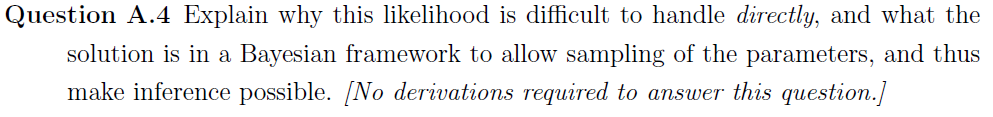


The likelihood function derived above is a product over doubly integrated densities of the bivariate normal distribution. Ultimately it employs the CDF of a multivariate normal distribution which has no closed-form solution.

There does not appear to exist a conjugate prior for this likelihood which would simplify the matters. And so, this troublesome density carries further to the posterior density.

Deriving the full conditional distributions for the parameters from the posterior would be an unfeasible task.

A easy solution, but, perhaps not very efficient, is to let a MCMC sampler to draws samples from the joint distribution. Such as it is being done in the Metropolis-Hastings algorithm.

Alternatively, one may augment the likelihood with the latent variables $y^*_1$ and $y^*_2$. This will then allow us to sample these variables, and conditional on them we will be able further to sample the regression coefficients.

---
---
## Part B: The MCMC sampler

---
### Question B.1

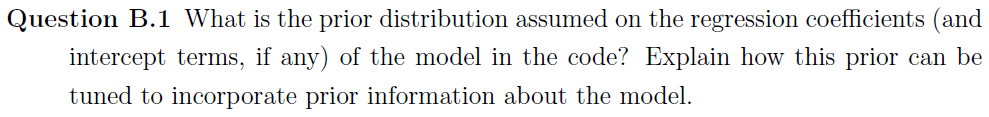

---
### Question B.2

---
### Question B.3

When $\texttt{sample\_rho=TRUE}$, Metropolis Hastings steps are being used to generate draws from the distribution of $\rho$.

In particular, candidate parameters are being sampled from a normal distribution centered at the previously accepted value and having a prespecified variance $\sigma^2_{\rho}=\mathtt{rho\_s2}$:
$$\rho^{new} = \rho^{old} + \mathcal{N}(0, \sigma^2_{\rho})$$
If no $\sigma^2_{\rho}$ is specified, then its value is set to $1/nobs \approx 0.000229463$ before the MCMC sampling is started.\\[2mm]
Next, if the new, candidate $\rho$ satisfies the precondition that in absolute value it should be less than 1, then we proceed to computing the log acceptance ratio:\\[1mm]

Let
    $\epsilon_i = \begin{pmatrix}
    y^*_{1i}-x'_i\beta_1-\delta y_{2i}\\
    y^*_{2i}-x'_i\beta_2-\gamma z_{i}
    \end{pmatrix}$
denote the errors from observation $i$ then the computations are equivalent to: 
\begin{equation*}
\begin{split}
lnR &= \sum_{i=1}^N \ln \left( \phi_2 \left( 
\begin{pmatrix}
    1 & \rho^{old}\\
    \rho^{old} & 1 
\end{pmatrix}^{-1/2} \epsilon_i \right)  \right) -
\sum_{i=1}^N \ln \left( \phi_2 \left(
    \begin{pmatrix}
        1 & \rho^{new}\\
        \rho^{new} & 1 
    \end{pmatrix}^{-1/2} \epsilon_i \right)  \right) \\
    & +\ln \left(\phi\left( \frac{\rho^{new}-\mathtt{rho\_mean0}}{\sqrt{\mathtt{rho\_var0}}} \right)\right) - 
    \ln \left(\phi\left( \frac{\rho^{old}-\mathtt{rho\_mean0}}{\sqrt{\mathtt{rho\_var0}}} \right)\right)
\end{split}
\end{equation*}
The draw is accepted if $\min(1, exp(lnR)) \geq u$, where u is a draw from the standard uniform distribution. If that does not happen then $\rho$ does not change.
One may infer from this procedure that the assumed prior for $\rho$ is the normal distribution with mean $\texttt{rho\_mean0}$ and variance $\texttt{rho\_var0}$: $$\rho\sim\mathcal{N}\left( \mathtt{rho\_mean0},\; \mathtt{rho\_var0}\right)$$.
    

---
### Question B.4

Setting a uniform prior $$$$ implies 

---
---
## Part C: Applications on synthetic and real data

---
### Question C.1

In [201]:
# Set seed
np.random.seed(seed=2018)

In [202]:
# Fix parameters
N = 1000
beta1, beta2 = 0.8, -0.4
delta, gamma = 0.5, 0.7
rho = 0.5

In [203]:
# Simulate data
x = np.random.normal(size=N)
z = np.random.normal(size=N)
eps1, eps2 = np.random.multivariate_normal(mean=[0,0], cov=[[1, rho],[rho, 1]], size=N).T

ystar2 = beta2*x + gamma*z + eps2
y2 = np.array(ystar2>0, dtype=int)

ystar1 = beta1*x + delta*y2 + eps1
y1 = np.array(ystar1>0, dtype=int)

---

In [204]:
# run the code in the notebook environment
%run -i mcmc_biprobit.py

In [205]:
# run this if you are willing to load the function in this cell
# %load mcmc_biprobit.py

In [206]:
%%time
# Without sampling rho
post = mcmc_biprobit(y1, y2, x1=np.column_stack([x,y2]), x2=np.column_stack([x,z]), sample_rho=False)

rep = 0
rep = 100
rep = 200
rep = 300
rep = 400
rep = 500
rep = 600
rep = 700
rep = 800
rep = 900
rep = 1000
rep = 1100
rep = 1200
rep = 1300
rep = 1400
rep = 1500
rep = 1600
rep = 1700
rep = 1800
rep = 1900
rep = 2000
rep = 2100
rep = 2200
rep = 2300
rep = 2400
rep = 2500
rep = 2600
rep = 2700
rep = 2800
rep = 2900
rep = 3000
rep = 3100
rep = 3200
rep = 3300
rep = 3400
rep = 3500
rep = 3600
rep = 3700
rep = 3800
rep = 3900
rep = 4000
rep = 4100
rep = 4200
rep = 4300
rep = 4400
rep = 4500
rep = 4600
rep = 4700
rep = 4800
rep = 4900
rep = 5000
rep = 5100
rep = 5200
rep = 5300
rep = 5400
rep = 5500
rep = 5600
rep = 5700
rep = 5800
rep = 5900
rep = 6000
rep = 6100
rep = 6200
rep = 6300
rep = 6400
rep = 6500
rep = 6600
rep = 6700
rep = 6800
rep = 6900
rep = 7000
rep = 7100
rep = 7200
rep = 7300
rep = 7400
rep = 7500
rep = 7600
rep = 7700
rep = 7800
rep = 7900
rep = 8000
rep = 8100
rep = 8200
rep = 8300
rep = 8400
rep = 8500
rep = 8600
rep = 8700
rep = 8800
rep = 8900
rep = 9000
rep = 9100


In [207]:
# Traceplots
xs = np.arange(1,len(post['rho'])+1)
trace1 = go.Scatter(x=xs, y=post['beta1'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace2 = go.Scatter(x=xs, y=post['beta1'][:,1], line=dict(width=0.5, color='#37AA9C'))
trace3 = go.Scatter(x=xs, y=post['beta2'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace4 = go.Scatter(x=xs, y=post['beta2'][:,1], line=dict(width=0.5, color='#37AA9C'))
fig1 = ff.create_distplot([post['beta1'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig2 = ff.create_distplot([post['beta1'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])
fig3 = ff.create_distplot([post['beta2'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig4 = ff.create_distplot([post['beta2'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])

fig = tools.make_subplots(rows=4, cols=2, print_grid=False, 
                          subplot_titles=('Beta1.1', '', 'Beta1.2', '', 'Beta2.1','', 'Beta2.2'))

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 3, 1)
fig.append_trace(trace4, 4, 1)
fig.append_trace(fig1['data'][0], 1, 2)
fig.append_trace(fig2['data'][0], 2, 2)
fig.append_trace(fig3['data'][0], 3, 2)
fig.append_trace(fig4['data'][0], 4, 2)

fig['layout'].update(height=800, title='Traceplot and corresponding densities', showlegend=False)

iplot(fig, show_link=False)

In [208]:
trace = np.column_stack([post['beta1'], post['beta2']])

In [209]:
# Means
np.mean(trace, axis=0)

array([ 0.76338004,  0.8909903 , -0.36670235,  0.68766323])

In [210]:
# Means
np.std(trace, axis=0)

array([0.05570245, 0.07244933, 0.04569004, 0.05094419])

In [211]:
# Quantiles
pm.stats.quantiles(trace)

{2.5: array([ 0.65598886,  0.75213634, -0.45769609,  0.58827341]),
 25: array([ 0.72615215,  0.84171979, -0.39782978,  0.65382893]),
 50: array([ 0.76267692,  0.89046523, -0.36630531,  0.68695173]),
 75: array([ 0.80053209,  0.93896398, -0.33512318,  0.7215042 ]),
 97.5: array([ 0.8741876 ,  1.03459488, -0.27844235,  0.78821331])}

In [212]:
# HPD
pm.stats.hpd(trace)

array([[ 0.6522976 ,  0.86967593],
       [ 0.75445317,  1.03642355],
       [-0.45863697, -0.2795824 ],
       [ 0.58910859,  0.78859152]])

In [213]:
summary = pd.DataFrame({'Mean': np.mean(trace, axis=0), 'StD': np.std(trace, axis=0)})\
.join(pd.DataFrame(pm.stats.hpd(trace)))
summary.columns = ['Mean', 'Std', '[95%','HPD]']
summary

,Mean,Std,[95%,HPD]
0,0.763380,0.055702,0.652298,0.869676
1,0.890990,0.072449,0.754453,1.036424
2,-0.366702,0.045690,-0.458637,-0.279582
3,0.687663,0.050944,0.589109,0.788592


---

In [214]:
%%time
# With samping rho
post = mcmc_biprobit(y1, y2, x1=np.column_stack([x,y2]), x2=np.column_stack([x,z]), sample_rho=True)

rep = 0
rep = 100
rep = 200
rep = 300
rep = 400
rep = 500
rep = 600
rep = 700
rep = 800
rep = 900
rep = 1000
rep = 1100
rep = 1200
rep = 1300
rep = 1400
rep = 1500
rep = 1600
rep = 1700
rep = 1800
rep = 1900
rep = 2000
rep = 2100
rep = 2200
rep = 2300
rep = 2400
rep = 2500
rep = 2600
rep = 2700
rep = 2800
rep = 2900
rep = 3000
rep = 3100
rep = 3200
rep = 3300
rep = 3400
rep = 3500
rep = 3600
rep = 3700
rep = 3800
rep = 3900
rep = 4000
rep = 4100
rep = 4200
rep = 4300
rep = 4400
rep = 4500
rep = 4600
rep = 4700
rep = 4800
rep = 4900
rep = 5000
rep = 5100
rep = 5200
rep = 5300
rep = 5400
rep = 5500
rep = 5600
rep = 5700
rep = 5800
rep = 5900
rep = 6000
rep = 6100
rep = 6200
rep = 6300
rep = 6400
rep = 6500
rep = 6600
rep = 6700
rep = 6800
rep = 6900
rep = 7000
rep = 7100
rep = 7200
rep = 7300
rep = 7400
rep = 7500
rep = 7600
rep = 7700
rep = 7800
rep = 7900
rep = 8000
rep = 8100
rep = 8200
rep = 8300
rep = 8400
rep = 8500
rep = 8600
rep = 8700
rep = 8800
rep = 8900
rep = 9000
rep = 9100


---
Analysis

In [215]:
# Traceplots
xs = np.arange(1,len(post['rho'])+1)
trace1 = go.Scatter(x=xs, y=post['beta1'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace2 = go.Scatter(x=xs, y=post['beta1'][:,1], line=dict(width=0.5, color='#37AA9C'))
trace3 = go.Scatter(x=xs, y=post['beta2'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace4 = go.Scatter(x=xs, y=post['beta2'][:,1], line=dict(width=0.5, color='#37AA9C'))
trace5 = go.Scatter(x=xs, y=post['rho'], line=dict(width=0.5, color='#37AA9C'))
fig1 = ff.create_distplot([post['beta1'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig2 = ff.create_distplot([post['beta1'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])
fig3 = ff.create_distplot([post['beta2'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig4 = ff.create_distplot([post['beta2'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])
fig5 = ff.create_distplot([post['rho']], ['rho'], show_hist=False, colors=['#333F44'])

fig = tools.make_subplots(rows=5, cols=2, print_grid=False, 
                          subplot_titles=('Beta1.1', '', 'Beta1.2', '', 'Beta2.1','', 'Beta2.2', '', 'rho'))

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 3, 1)
fig.append_trace(trace4, 4, 1)
fig.append_trace(trace5, 5, 1)
fig.append_trace(fig1['data'][0], 1, 2)
fig.append_trace(fig2['data'][0], 2, 2)
fig.append_trace(fig3['data'][0], 3, 2)
fig.append_trace(fig4['data'][0], 4, 2)
fig.append_trace(fig5['data'][0], 5, 2)

fig['layout'].update(height=900, title='Traceplot and corresponding densities', showlegend=False)

iplot(fig, show_link=False)

In [216]:
trace = np.column_stack([post['beta1'], post['beta2'], post['rho']])

In [217]:
# Means
np.mean(trace, axis=0)

array([ 0.71526233,  0.54578669, -0.36375367,  0.70754065,  0.50357352])

In [218]:
# Means
np.std(trace, axis=0)

array([0.05717497, 0.08755613, 0.04792781, 0.05178699, 0.06196342])

In [219]:
# Quantiles
pm.stats.quantiles(trace)

{2.5: array([ 0.60357895,  0.37357405, -0.45840317,  0.60720228,  0.37761694]),
 25: array([ 0.67654773,  0.48683171, -0.39640938,  0.67191191,  0.46243627]),
 50: array([ 0.71493148,  0.54418395, -0.36386727,  0.70705323,  0.50651079]),
 75: array([ 0.75297401,  0.60379964, -0.33169896,  0.74198484,  0.5443579 ]),
 97.5: array([ 0.83016659,  0.71735727, -0.26967453,  0.80829427,  0.6164043 ])}

In [220]:
# HPD
pm.stats.hpd(trace)

array([[ 0.59658334,  0.82263046],
       [ 0.3773089 ,  0.71940704],
       [-0.45808022, -0.26960765],
       [ 0.60975956,  0.80987952],
       [ 0.37812887,  0.61651222]])

In [221]:
summary = pd.DataFrame({'Mean': np.mean(trace, axis=0), 'StD': np.std(trace, axis=0)})\
.join(pd.DataFrame(pm.stats.hpd(trace)))
summary.columns = ['Mean', 'Std', '[95%','HPD]']
summary

,Mean,Std,[95%,HPD]
0,0.715262,0.057175,0.596583,0.822630
1,0.545787,0.087556,0.377309,0.719407
2,-0.363754,0.047928,-0.458080,-0.269608
3,0.707541,0.051787,0.609760,0.809880
4,0.503574,0.061963,0.378129,0.616512


In [222]:
# Acceptance rate and lag(10) ACF

---
### Question C.2

In [223]:
# Set seed
np.random.seed(seed=2018)

In [224]:
# Load the data
df = pd.read_csv("fertility.csv")
df.head()

,kids,educ,age,agesq,tv,electric,urban,evermarr,fhalf
0,0,1,2.4,0.576,1,1,1,0,1
1,1,1,3.2,1.024,1,1,1,1,1
2,1,0,3.0,0.900,0,1,1,1,0
3,1,0,4.2,1.764,1,1,1,1,0
4,1,1,4.3,1.849,1,1,1,1,1


In [225]:
df.describe()

,kids,educ,age,agesq,tv,electric,urban,evermarr,fhalf
count,4358.000000,4358.000000,4358.000000,4358.000000,4358.000000,4358.000000,4358.000000,4358.000000,4358.000000
mean,0.740248,0.289123,2.740431,0.826424,0.092933,0.140202,0.516521,0.476365,0.540385
std,0.438549,0.453407,0.868588,0.526962,0.290371,0.347236,0.499784,0.499498,0.498424
min,0.000000,0.000000,1.500000,0.225000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,2.000000,0.400000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.000000,2.600000,0.676000,0.000000,0.000000,1.000000,0.000000,1.000000
75%,1.000000,1.000000,3.300000,1.089000,0.000000,0.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,4.900000,2.401000,1.000000,1.000000,1.000000,1.000000,1.000000


In [226]:
# Prepare variables
y1 = df['kids'].values
y2 = df['educ'].values
X = df[['age', 'agesq', 'tv', 'urban', 'evermarr']].values
X1 = np.column_stack([np.ones(len(y1)),X])
z = df['fhalf'].values

---

In [227]:
%run -i mcmc_biprobit.py

In [228]:
post = mcmc_biprobit(y1, y2, np.column_stack([X1,y2]), x2=np.column_stack([X1,z]), sample_rho=True)

rep = 0
rep = 100
rep = 200
rep = 300
rep = 400
rep = 500
rep = 600
rep = 700
rep = 800
rep = 900
rep = 1000
rep = 1100
rep = 1200
rep = 1300
rep = 1400
rep = 1500
rep = 1600
rep = 1700
rep = 1800
rep = 1900
rep = 2000
rep = 2100
rep = 2200
rep = 2300
rep = 2400
rep = 2500
rep = 2600
rep = 2700
rep = 2800
rep = 2900
rep = 3000
rep = 3100
rep = 3200
rep = 3300
rep = 3400
rep = 3500
rep = 3600
rep = 3700
rep = 3800
rep = 3900
rep = 4000
rep = 4100
rep = 4200
rep = 4300
rep = 4400
rep = 4500
rep = 4600
rep = 4700
rep = 4800
rep = 4900
rep = 5000
rep = 5100
rep = 5200
rep = 5300
rep = 5400
rep = 5500
rep = 5600
rep = 5700
rep = 5800
rep = 5900
rep = 6000
rep = 6100
rep = 6200
rep = 6300
rep = 6400
rep = 6500
rep = 6600
rep = 6700
rep = 6800
rep = 6900
rep = 7000
rep = 7100
rep = 7200
rep = 7300
rep = 7400
rep = 7500
rep = 7600
rep = 7700
rep = 7800
rep = 7900
rep = 8000
rep = 8100
rep = 8200
rep = 8300
rep = 8400
rep = 8500
rep = 8600
rep = 8700
rep = 8800
rep = 8900
rep = 9000
rep = 9100


---
Analysis

In [229]:
post['beta1'].shape

(10000, 7)

In [230]:
post['beta2'].shape

(10000, 7)

In [231]:
# Traceplots
xs = np.arange(1,len(post['rho'])+1)
trace1 = go.Scatter(x=xs, y=post['beta1'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace2 = go.Scatter(x=xs, y=post['beta1'][:,1], line=dict(width=0.5, color='#37AA9C'))
trace3 = go.Scatter(x=xs, y=post['beta1'][:,2], line=dict(width=0.5, color='#37AA9C'))
trace4 = go.Scatter(x=xs, y=post['beta1'][:,3], line=dict(width=0.5, color='#37AA9C'))
trace5 = go.Scatter(x=xs, y=post['beta1'][:,4], line=dict(width=0.5, color='#37AA9C'))
trace6 = go.Scatter(x=xs, y=post['beta1'][:,5], line=dict(width=0.5, color='#37AA9C'))
trace7 = go.Scatter(x=xs, y=post['beta1'][:,6], line=dict(width=0.5, color='#37AA9C'))
trace8 = go.Scatter(x=xs, y=post['beta2'][:,0], line=dict(width=0.5, color='#37AA9C'))
trace9 = go.Scatter(x=xs, y=post['beta2'][:,1], line=dict(width=0.5, color='#37AA9C'))
trace10 = go.Scatter(x=xs, y=post['beta2'][:,2], line=dict(width=0.5, color='#37AA9C'))
trace11 = go.Scatter(x=xs, y=post['beta2'][:,3], line=dict(width=0.5, color='#37AA9C'))
trace12 = go.Scatter(x=xs, y=post['beta2'][:,4], line=dict(width=0.5, color='#37AA9C'))
trace13 = go.Scatter(x=xs, y=post['beta2'][:,5], line=dict(width=0.5, color='#37AA9C'))
trace14 = go.Scatter(x=xs, y=post['beta2'][:,6], line=dict(width=0.5, color='#37AA9C'))
trace15 = go.Scatter(x=xs, y=post['rho'], line=dict(width=0.5, color='#37AA9C'))
fig1 = ff.create_distplot([post['beta1'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig2 = ff.create_distplot([post['beta1'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])
fig3 = ff.create_distplot([post['beta1'][:,2]], ['beta'], show_hist=False, colors=['#333F44'])
fig4 = ff.create_distplot([post['beta1'][:,3]], ['beta'], show_hist=False, colors=['#333F44'])
fig5 = ff.create_distplot([post['beta1'][:,4]], ['beta'], show_hist=False, colors=['#333F44'])
fig6 = ff.create_distplot([post['beta1'][:,5]], ['beta'], show_hist=False, colors=['#333F44'])
fig7 = ff.create_distplot([post['beta1'][:,6]], ['beta'], show_hist=False, colors=['#333F44'])
fig8 = ff.create_distplot([post['beta2'][:,0]], ['beta'], show_hist=False, colors=['#333F44'])
fig9 = ff.create_distplot([post['beta2'][:,1]], ['beta'], show_hist=False, colors=['#333F44'])
fig10 = ff.create_distplot([post['beta2'][:,2]], ['beta'], show_hist=False, colors=['#333F44'])
fig11 = ff.create_distplot([post['beta2'][:,3]], ['beta'], show_hist=False, colors=['#333F44'])
fig12 = ff.create_distplot([post['beta2'][:,4]], ['beta'], show_hist=False, colors=['#333F44'])
fig13 = ff.create_distplot([post['beta2'][:,5]], ['beta'], show_hist=False, colors=['#333F44'])
fig14 = ff.create_distplot([post['beta2'][:,6]], ['beta'], show_hist=False, colors=['#333F44'])
fig15 = ff.create_distplot([post['rho']], ['rho'], show_hist=False, colors=['#333F44'])

fig = tools.make_subplots(rows=15, cols=2, print_grid=False, 
                          subplot_titles=('Beta1.int', '', 'Beta1.age', '','Beta1.agesq','', 'Beta1.tv','', 'Beta1.urban', '', 'Beta1.evermarr','', 'delta','', ''
                                          'Beta2.int', '', 'Beta2.age', '', 'Beta2.agesq','', 'Beta2.tv','', 'Beta2.urban', '', 'Beta2.evermarr','','gamma','',
                                          'rho'   ))

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 2, 1)
fig.append_trace(trace3, 3, 1)
fig.append_trace(trace4, 4, 1)
fig.append_trace(trace5, 5, 1)
fig.append_trace(trace6, 6, 1)
fig.append_trace(trace7, 7, 1)
fig.append_trace(trace8, 8, 1)
fig.append_trace(trace9, 9, 1)
fig.append_trace(trace10, 10, 1)
fig.append_trace(trace11, 11, 1)
fig.append_trace(trace12, 12, 1)
fig.append_trace(trace13, 13, 1)
fig.append_trace(trace14, 14, 1)
fig.append_trace(trace15, 15, 1)
fig.append_trace(fig1['data'][0], 1, 2)
fig.append_trace(fig2['data'][0], 2, 2)
fig.append_trace(fig3['data'][0], 3, 2)
fig.append_trace(fig4['data'][0], 4, 2)
fig.append_trace(fig5['data'][0], 5, 2)
fig.append_trace(fig6['data'][0], 6, 2)
fig.append_trace(fig7['data'][0], 7, 2)
fig.append_trace(fig8['data'][0], 8, 2)
fig.append_trace(fig9['data'][0], 9, 2)
fig.append_trace(fig10['data'][0], 10, 2)
fig.append_trace(fig11['data'][0], 11, 2)
fig.append_trace(fig12['data'][0], 12, 2)
fig.append_trace(fig13['data'][0], 13, 2)
fig.append_trace(fig14['data'][0], 14, 2)
fig.append_trace(fig15['data'][0], 15, 2)

fig['layout'].update(height=2600, title='Traceplot and corresponding densities', showlegend=False)

iplot(fig, show_link=False)

In [232]:
trace = np.column_stack([post['beta1'], post['beta2'], post['rho']])

In [233]:
# Means
np.mean(trace, axis=0)

array([-6.39752379,  4.62408526, -6.37503532,  0.12065312, -0.01893359,
        0.27242818, -0.84084342, -0.25503372,  0.05346259, -0.60064634,
        1.13966175,  0.22804636, -0.31859648, -0.17776125,  0.39964349])

In [234]:
# Means
np.std(trace, axis=0)

array([0.53861867, 0.30989586, 0.45384734, 0.19709151, 0.06200677,
       0.08096183, 0.41420709, 0.25814919, 0.18705991, 0.31123331,
       0.07440247, 0.04626459, 0.0547345 , 0.04278357, 0.24561933])

In [235]:
# Quantiles
pm.stats.quantiles(trace)

{2.5: array([-7.44050839,  4.01472339, -7.22604182, -0.38241423, -0.14599798,
         0.12308348, -1.38209322, -0.75983   , -0.31036103, -1.21414516,
         0.99382216,  0.13678218, -0.42485005, -0.2612559 , -0.29064857]),
 25: array([-6.77363459,  4.40978156, -6.69322193,  0.02460567, -0.05954892,
         0.21668466, -1.1136218 , -0.42846182, -0.07175666, -0.80619293,
         1.09075721,  0.19708213, -0.35575907, -0.20715939,  0.30423362]),
 50: array([-6.37243873,  4.62855158, -6.38265267,  0.15513304, -0.01685085,
         0.26838368, -0.96207097, -0.25371131,  0.05242136, -0.59940233,
         1.13963526,  0.22936437, -0.31840611, -0.17767018,  0.47918079]),
 75: array([-6.01590376,  4.84347773, -6.06723035,  0.25596457,  0.02255627,
         0.32579889, -0.67286484, -0.08263788,  0.17748385, -0.39392738,
         1.1891147 ,  0.2593769 , -0.28155266, -0.14833516,  0.56107271]),
 97.5: array([-5.38815476,  5.20902412, -5.47938901,  0.42254597,  0.09802712,
         0.43982764,

In [236]:
# HPD
pm.stats.hpd(trace)

array([[-7.45889129, -5.42244562],
       [ 4.02683868,  5.21668356],
       [-7.24272564, -5.50283349],
       [-0.32917396,  0.45452748],
       [-0.14271208,  0.10065559],
       [ 0.11827094,  0.43401929],
       [-1.44919336,  0.21228879],
       [-0.76067419,  0.24578237],
       [-0.29977978,  0.42995083],
       [-1.24652341, -0.02405925],
       [ 0.99103753,  1.28320011],
       [ 0.13887284,  0.32004688],
       [-0.42428192, -0.20990305],
       [-0.26019074, -0.09460586],
       [-0.19898564,  0.76648237]])

In [237]:
summary = pd.DataFrame({'Mean': np.mean(trace, axis=0), 'StD': np.std(trace, axis=0)})\
.join(pd.DataFrame(pm.stats.hpd(trace)))
summary.columns = ['Mean', 'Std', '[95%','HPD]']
summary

,Mean,Std,[95%,HPD]
0,-6.397524,0.538619,-7.458891,-5.422446
1,4.624085,0.309896,4.026839,5.216684
2,-6.375035,0.453847,-7.242726,-5.502833
3,0.120653,0.197092,-0.329174,0.454527
4,-0.018934,0.062007,-0.142712,0.100656
5,0.272428,0.080962,0.118271,0.434019
6,-0.840843,0.414207,-1.449193,0.212289
7,-0.255034,0.258149,-0.760674,0.245782
8,0.053463,0.187060,-0.299780,0.429951
9,-0.600646,0.311233,-1.246523,-0.024059


---

In [ ]:
# pm.stats.r2_score(y_true, y_pred, round_to=2)

In [238]:
# trace = go.Scatter(y = pm.stats.autocorr(post['rho']),
#                   mode = 'markers')
# iplot([trace], show_link=False)

Convergence & Mixing

Do not converges to the appropriate densities.

Evaluate MCMC algorithm performance, evaluating model fit, and comparing models.